In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.figure_factory as ff

%load_ext autoreload
%autoreload 2
import color

df = pd.read_pickle('data/final_dataset.pk1')

In [2]:
df.dtypes

name                 object
total_pop             int64
median_income       float64
state                object
county               object
county_name          object
state_name           object
prop_white          float64
prop_black          float64
prop_hisp           float64
log_med_income      float64
prop_no_internet    float64
prop_ba             float64
prop_services       float64
pop_density          object
FIPS                float64
covid_cases           int64
Testing_Rate        float64
gov_party             int64
election_diff       float64
Apr-19               object
Mar-19               object
Feb-20               object
Mar-20               object
days_closed         float64
dtype: object

In [3]:
#change in merge_data.py?
for col in ['Mar-19','Apr-19','Feb-20','Mar-20']:
    df[col] = pd.to_numeric(df[col])

#df['days_closed'] = df['days_closed'].astype(int)

In [4]:
# Changing colors: https://betterfigures.org/2015/06/23/picking-a-colour-scale-for-scientific-graphics/
# Color blind scale: https://davidmathlogic.com/colorblind/#%23C4D7EC-%23D41159

colorscale = ['rgb(194,213,236)',
        'rgb(155,194,220)',
        'rgb(109,163,208)',
        'rgb(75,133,190)',
        'rgb(52,99,172)',
        'rgb(24,39,98)']

# posnegscale = ['rgb(225,194,10)',
#     'rgb(245,218,138)',
#     'rgb(205,225,247)',
#     'rgb(134,188,249)',     
#     'rgb(26,133,255)',
#     'rgb(26,133,255)']

posnegscale = ['rgb(153,79,0)',
            'rgb(216,179,140)',
            'rgb(197,219,241)',
            'rgb(102,164,222)',     
            'rgb(0,108,209)',
            'rgb(0,108,209)']


# Probably deconstruct to be able to adjust bins manually
def map_by_county(att, df=df, title=None, colorscale=colorscale):
    values = df[att].tolist()
    fips = df['FIPS'].tolist()

    bins = df[att].describe().tolist()[3:]
    if not title:
        title = att + " by County"

    fig = ff.create_choropleth(
        fips=fips, values=values, binning_endpoints=bins, colorscale=colorscale,
        county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
        legend_title=att, title=title
    )
    fig.layout.template = None
    
    return fig

# Unemployment #

In [5]:
### In color module, attempts to automate, but removes some finesse, just going tor rework by hand once we decide what should go into the deliverables
# def map_by_county(att, df=df, scale=True, title=None):
#     values = df[att].tolist()
#     fips = df['FIPS'].tolist()

#     bins = color.set_bins(att, df)
#     colorscale = color.gen_gradient((len(bins)+2), scale)

#     if not title:
#         title = att + " by County"

#     fig = ff.create_choropleth(
#         fips=fips, values=values, binning_endpoints=bins, colorscale=colorscale,
#         county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
#         legend_title=att, title=title
#     )
#     fig.layout.template = None
    
#     return fig

In [6]:
map_by_county('Mar-20', title="Unemployment by County, April 2020") #Change to April

In [7]:
# Comparison data
map_by_county('Feb-20', title="Unemployment by County, February 2020")

In [8]:
# Comparison data
map_by_county('Apr-19', title="Unemployment by County, April 2019")

<function matplotlib.pyplot.show(*args, **kw)>

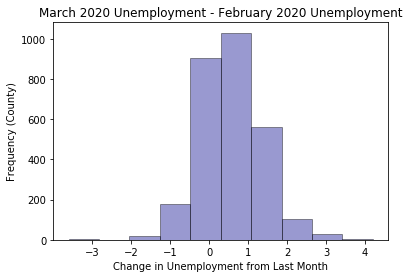

In [9]:
change = df[['Mar-19','Apr-19','Feb-20','Mar-20','FIPS']].copy()
change['prev_month'] = change['Mar-20'] - change['Feb-20'] #change to April #does this ordering make sense/intuitive
change['prev_year'] = change['Mar-20'] - change['Mar-19'] #change to April

sns.distplot(change['prev_month'], hist=True, kde=False, 
             bins=10, color = 'darkblue', 
              hist_kws={'edgecolor':'black'},
              kde_kws={'linewidth': 4})
plt.xlabel('Change in Unemployment from Last Month')
plt.ylabel('Frequency (County)')
plt.title('March 2020 Unemployment - February 2020 Unemployment')
plt.show

In [10]:
map_by_county('prev_month', df=change, colorscale=posnegscale)
#if we use this, we can adjust bins outside of the function to be strictly positive/negative

<function matplotlib.pyplot.show(*args, **kw)>

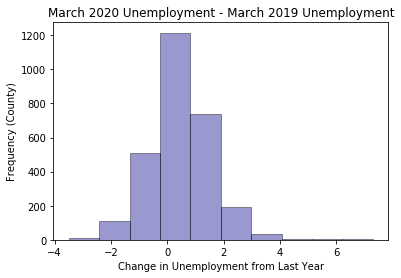

In [11]:
sns.distplot(change['prev_year'], hist=True, kde=False, 
             bins=10, color = 'darkblue', 
              hist_kws={'edgecolor':'black'},
              kde_kws={'linewidth': 4})
plt.xlabel('Change in Unemployment from Last Year')
plt.ylabel('Frequency (County)')
plt.title('March 2020 Unemployment - March 2019 Unemployment')
plt.show

In [12]:
map_by_county('prev_year', df=change, colorscale=posnegscale) # if we end up using this, change funciton to use same bins as previous year??

<function matplotlib.pyplot.show(*args, **kw)>

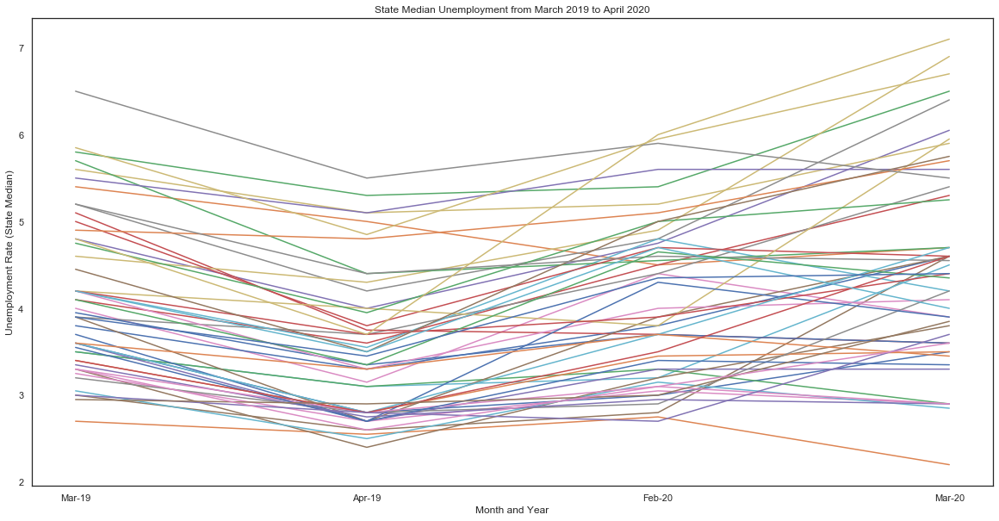

In [13]:
unemp = df[['Mar-19','Apr-19','Feb-20','Mar-20']].groupby(df['state_name']).agg('median').reset_index()
unemp = unemp.transpose()
new_header = unemp.iloc[0] #grab the first row for the header
unemp = unemp[1:] #take the data less the header row
unemp.columns = new_header

sns.set(rc={'figure.figsize':(20, 10)})
sns.set_style('white')
fig, ax = plt.subplots()
for state in unemp.columns:
    ax.plot(unemp.index, unemp[state], label=state)

#leg = ax.legend(frameon=False, loc='best'); #these are the state lables ?? how best to show them
plt.xlabel("Month and Year")
plt.ylabel("Unemployment Rate (State Median)")
plt.title("State Median Unemployment from March 2019 to April 2020")
plt.show

## COVID-19 Data

In [14]:
df['covid_cases'].describe().tolist()[3:]

[0.0, 6.0, 23.0, 98.0, 167478.0]

In [15]:
map_by_county('covid_cases', title="Covid Cases")

<function matplotlib.pyplot.show(*args, **kw)>

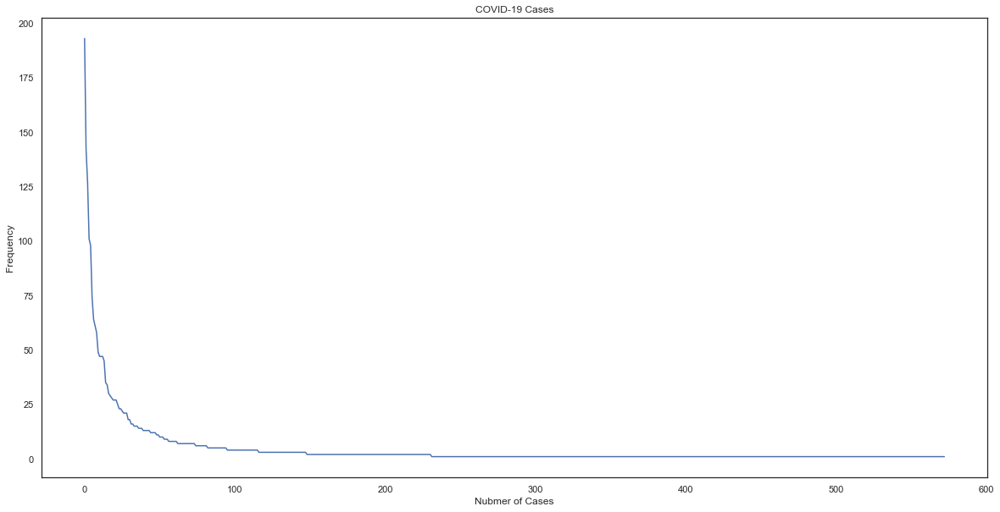

In [16]:
count_cases = df['covid_cases'].value_counts().sort_values(ascending=False).reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['covid_cases'])
plt.title("COVID-19 Cases")
plt.xlabel("Nubmer of Cases")
plt.ylabel("Frequency")
plt.show

In [17]:
map_by_county('Testing_Rate', title="Testing Rate")

<function matplotlib.pyplot.show(*args, **kw)>

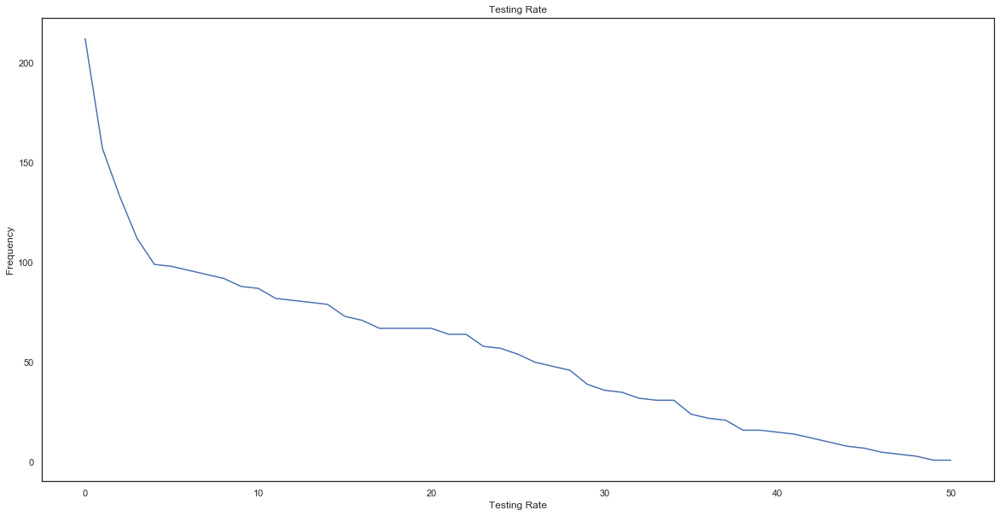

In [18]:
count_cases = df['Testing_Rate'].value_counts().sort_values(ascending=False).reset_index().reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['Testing_Rate'])
plt.title("Testing Rate")
plt.xlabel("Testing Rate")
plt.ylabel("Frequency")
plt.show

In [19]:
map_by_county('days_closed', title="Days Closed on April 20")

<function matplotlib.pyplot.show(*args, **kw)>

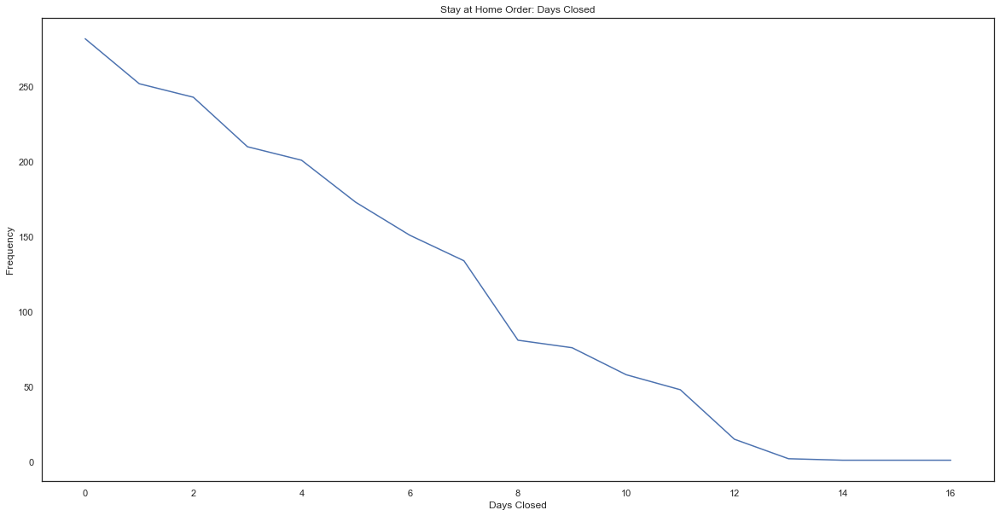

In [20]:
count_cases = df['days_closed'].value_counts().sort_values(ascending=False).reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['days_closed'])
plt.title("Stay at Home Order: Days Closed")
plt.xlabel("Days Closed")
plt.ylabel("Frequency")
plt.show

## Unemployment and COVID-19 Data

<function matplotlib.pyplot.show(*args, **kw)>

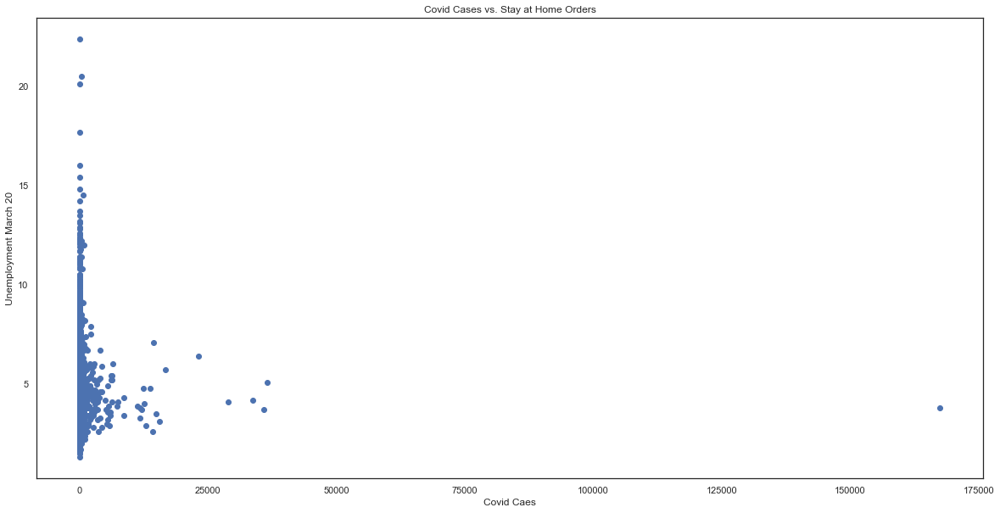

In [21]:
plt.scatter(x=df['covid_cases'], y=df['Mar-20'])
plt.title("Covid Cases vs. Stay at Home Orders")
plt.xlabel("Covid Caes")
plt.ylabel("Unemployment March 20")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

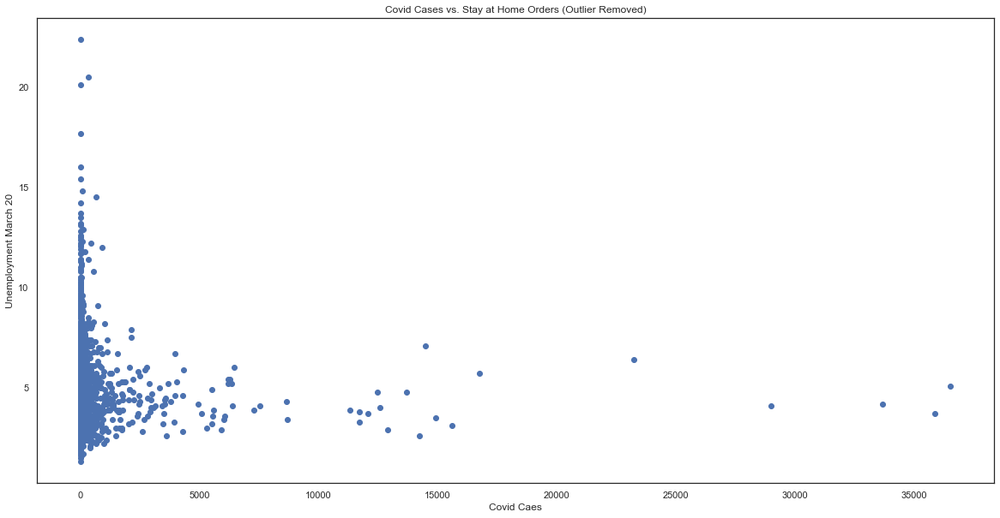

In [22]:
no_outlier = df[df['covid_cases'] != df['covid_cases'].agg('max')]
plt.scatter(x=no_outlier['covid_cases'], y=no_outlier['Mar-20'])
plt.title("Covid Cases vs. Stay at Home Orders (Outlier Removed)")
plt.xlabel("Covid Caes")
plt.ylabel("Unemployment March 20")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

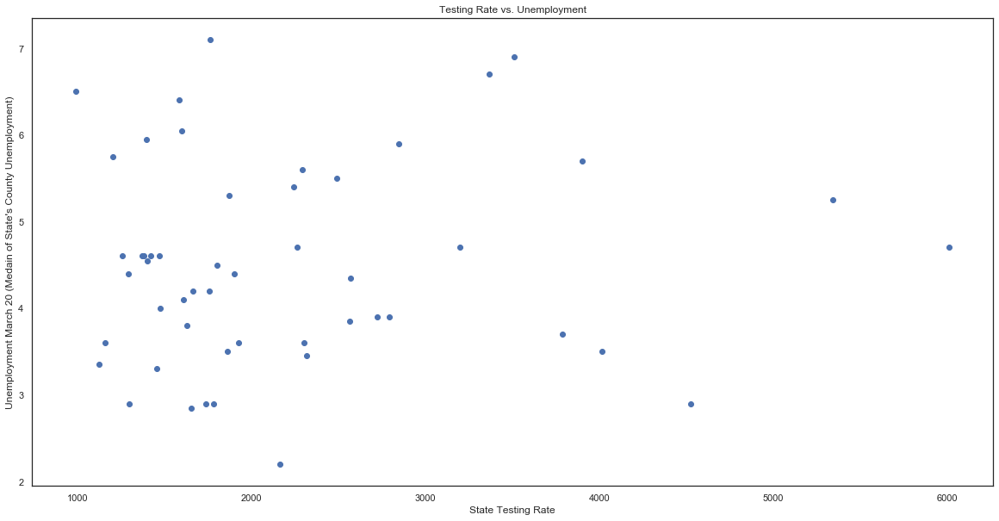

In [23]:
state_unemp = df['Mar-20'].groupby(df['state_name']).agg('median').reset_index()
test_unemp = state_unemp.merge(df[['state_name', 'Testing_Rate']]).drop_duplicates()

plt.scatter(x=test_unemp['Testing_Rate'], y=test_unemp['Mar-20'])
plt.title("Testing Rate vs. Unemployment")
plt.xlabel("State Testing Rate")
plt.ylabel("Unemployment March 20 (Medain of State's County Unemployment)")
plt.show

## Demographic Trends

In [24]:
def dem_trends(att):
    fig, (ax1,ax2) = plt.subplots(1,2)
    title = 'Unemployment and COVID Cases, variation by ' + att
    fig.suptitle(title)
    ax1.scatter(df[att],df['Mar-20'])
    ax1.set(xlabel=att, ylabel="Unemployment March 2020")

    ax2.scatter(df[att], df['covid_cases'])
    ax2.set(xlabel=att, ylabel="COVID Cases")
    
    return fig

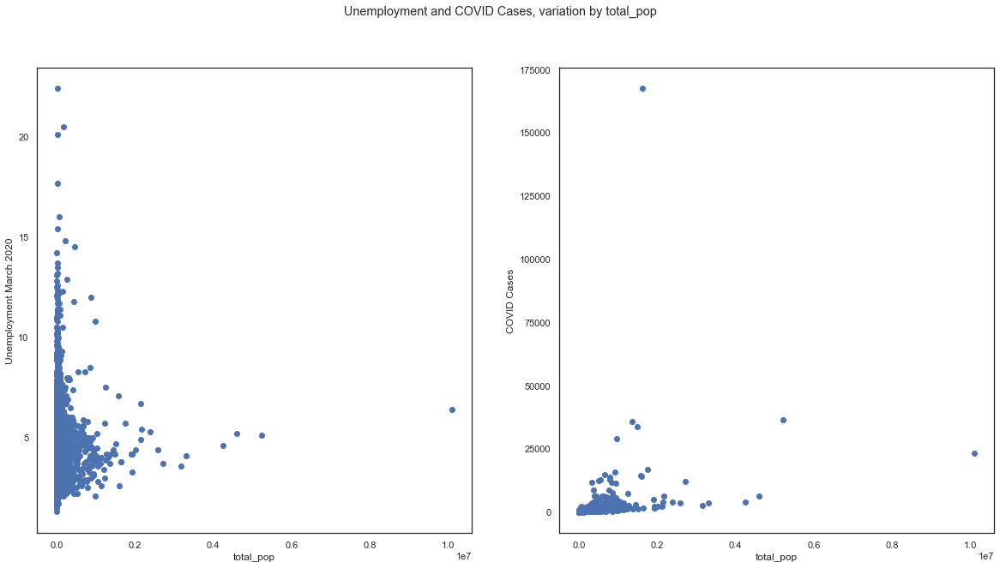

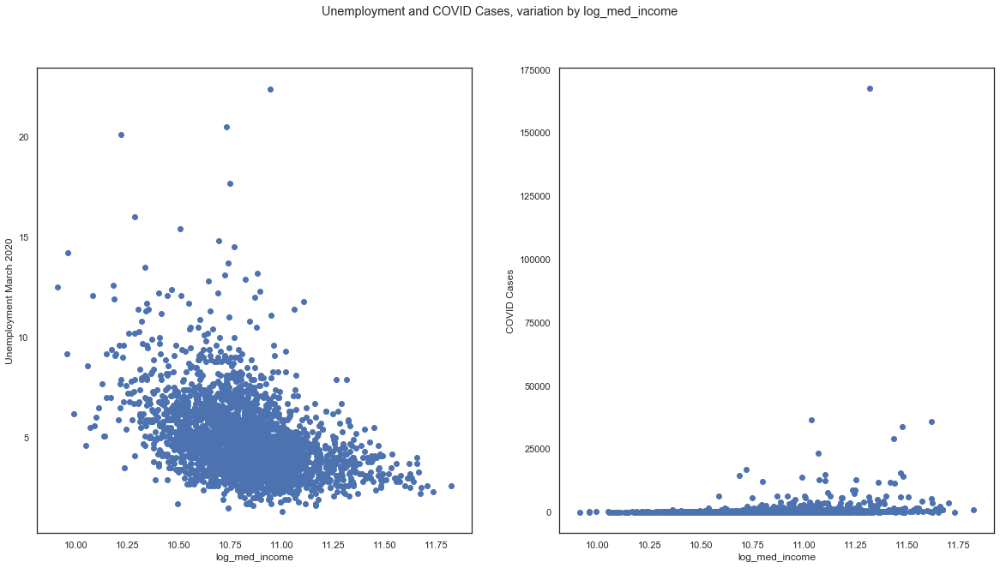

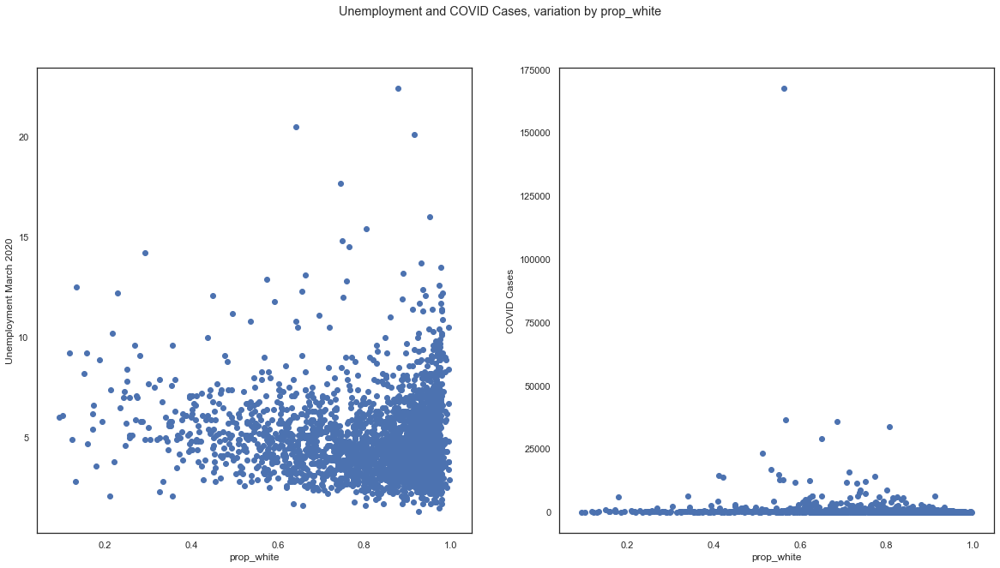

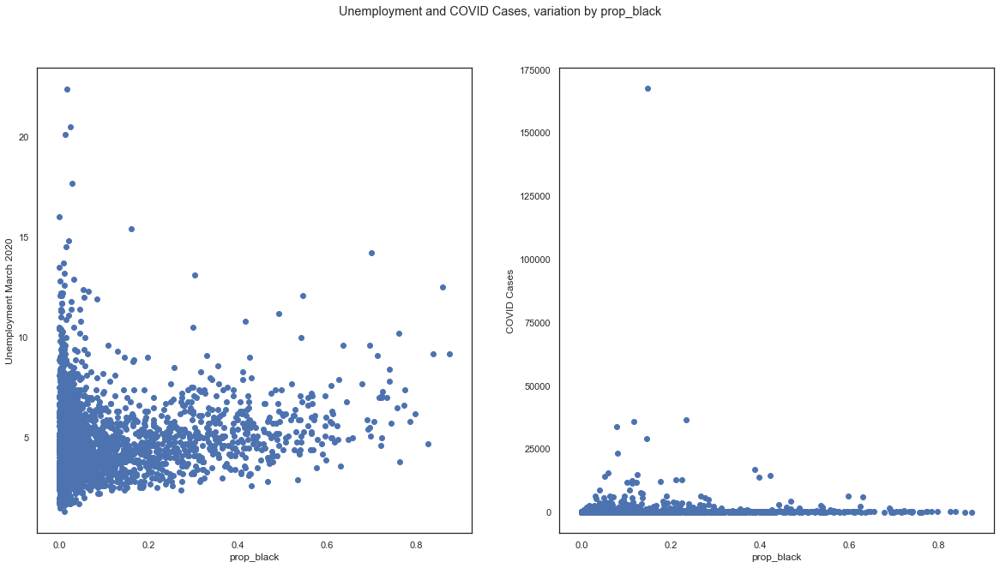

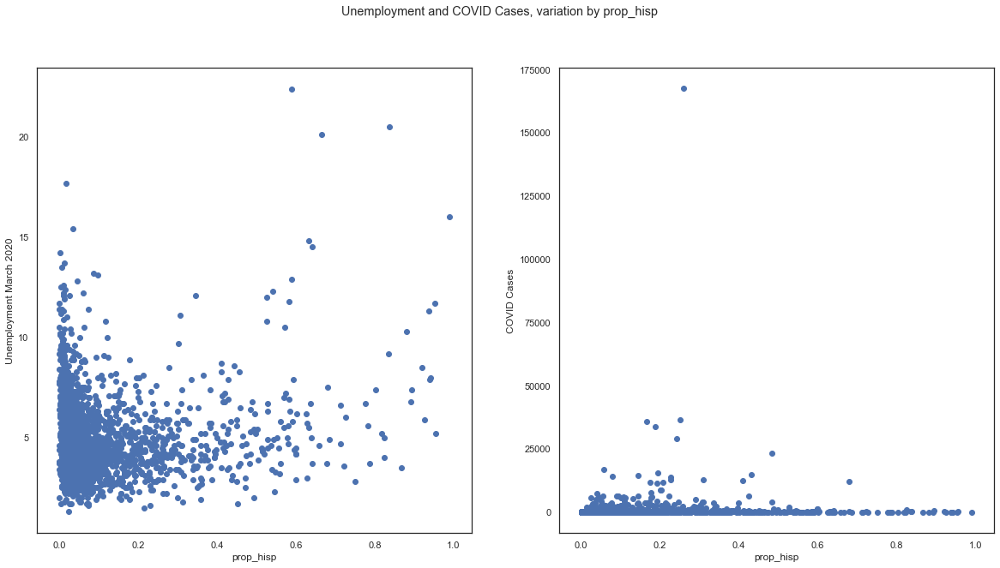

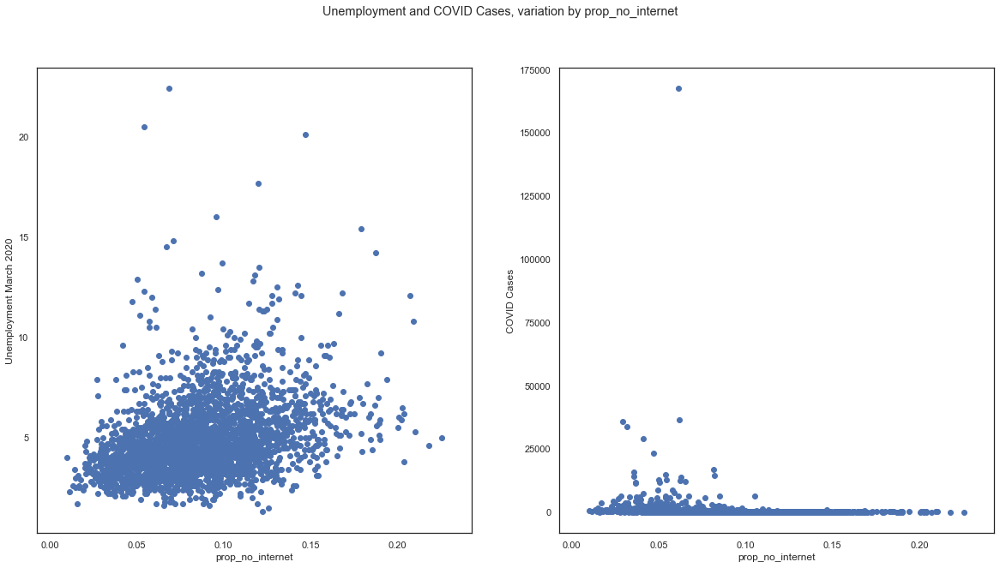

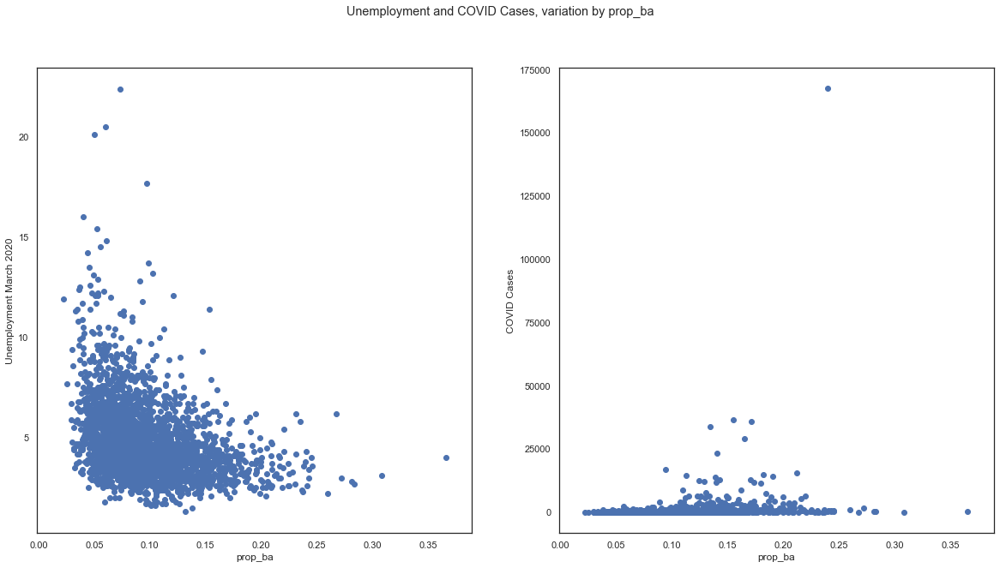

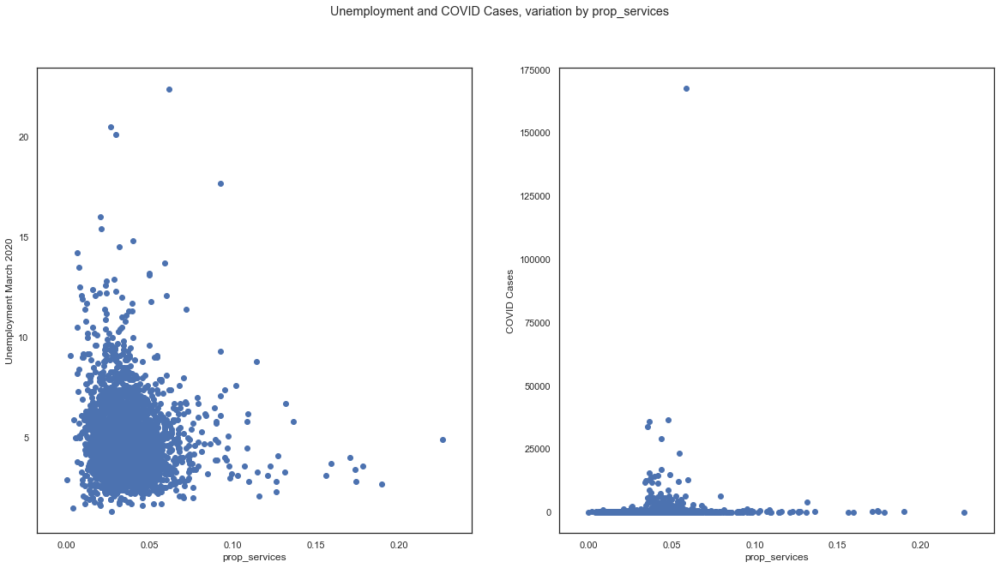

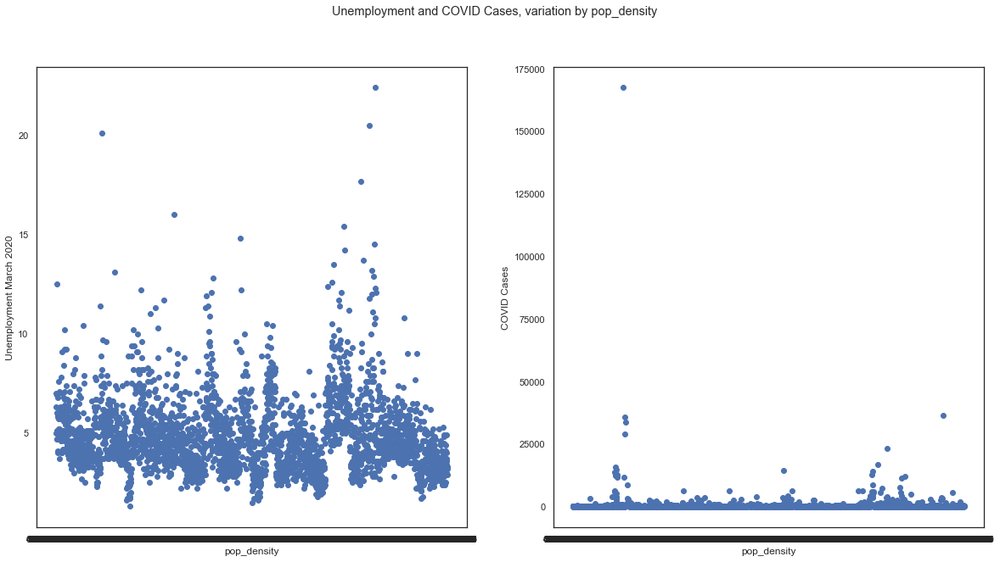

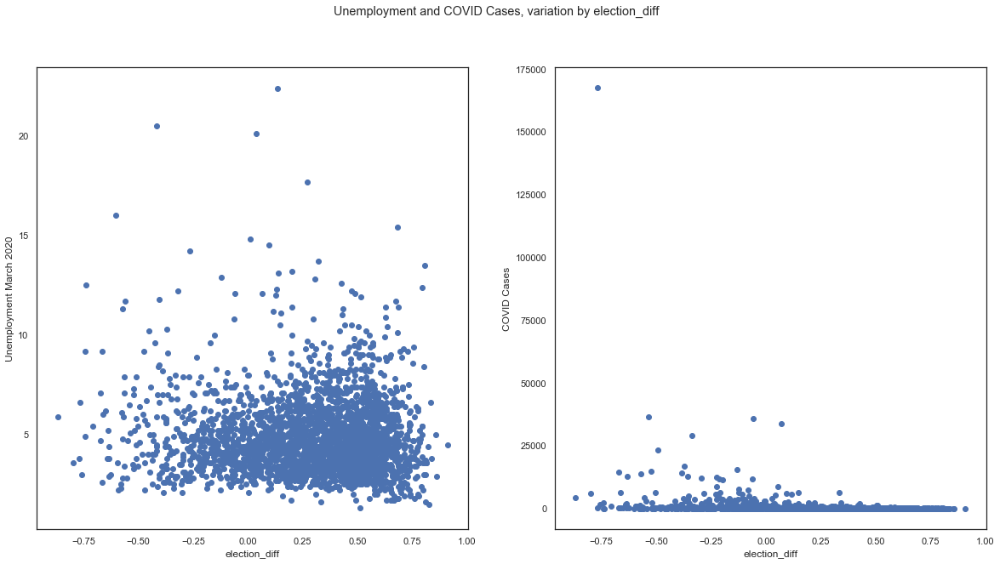

In [25]:
dems = ['total_pop','log_med_income','prop_white', 'prop_black', 'prop_hisp', 'prop_no_internet', 'prop_ba',
        'prop_services', 'pop_density','election_diff']

for dem in dems:
    dem_trends(dem)